In [1]:
import pandas as pd
import seaborn as sns
import sklearn 

In [4]:
df = pd.read_csv('../data/bank/bank.csv', sep=';')
df.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,y
0,30,unemployed,married,primary,no,1787,no,no,cellular,19,oct,79,1,-1,0,unknown,no
1,33,services,married,secondary,no,4789,yes,yes,cellular,11,may,220,1,339,4,failure,no
2,35,management,single,tertiary,no,1350,yes,no,cellular,16,apr,185,1,330,1,failure,no
3,30,management,married,tertiary,no,1476,yes,yes,unknown,3,jun,199,4,-1,0,unknown,no
4,59,blue-collar,married,secondary,no,0,yes,no,unknown,5,may,226,1,-1,0,unknown,no


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4521 entries, 0 to 4520
Data columns (total 17 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   age        4521 non-null   int64 
 1   job        4521 non-null   object
 2   marital    4521 non-null   object
 3   education  4521 non-null   object
 4   default    4521 non-null   object
 5   balance    4521 non-null   int64 
 6   housing    4521 non-null   object
 7   loan       4521 non-null   object
 8   contact    4521 non-null   object
 9   day        4521 non-null   int64 
 10  month      4521 non-null   object
 11  duration   4521 non-null   int64 
 12  campaign   4521 non-null   int64 
 13  pdays      4521 non-null   int64 
 14  previous   4521 non-null   int64 
 15  poutcome   4521 non-null   object
 16  y          4521 non-null   object
dtypes: int64(7), object(10)
memory usage: 600.6+ KB


In [7]:
df.describe()

,age,balance,day,duration,campaign,pdays,previous
count,4521.000000,4521.000000,4521.000000,4521.000000,4521.000000,4521.000000,4521.000000
mean,41.170095,1422.657819,15.915284,263.961292,2.793630,39.766645,0.542579
std,10.576211,3009.638142,8.247667,259.856633,3.109807,100.121124,1.693562
min,19.000000,-3313.000000,1.000000,4.000000,1.000000,-1.000000,0.000000
25%,33.000000,69.000000,9.000000,104.000000,1.000000,-1.000000,0.000000
50%,39.000000,444.000000,16.000000,185.000000,2.000000,-1.000000,0.000000
75%,49.000000,1480.000000,21.000000,329.000000,3.000000,-1.000000,0.000000
max,87.000000,71188.000000,31.000000,3025.000000,50.000000,871.000000,25.000000


In [12]:
from scipy import stats
import numpy as np

In [38]:
a = np.abs(stats.zscore(df['balance']))<float(2)

In [41]:
df[(np.abs(stats.zscore(df['balance']))<float(2))]

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,y
0,30,unemployed,married,primary,no,1787,no,no,cellular,19,oct,79,1,-1,0,unknown,no
1,33,services,married,secondary,no,4789,yes,yes,cellular,11,may,220,1,339,4,failure,no
2,35,management,single,tertiary,no,1350,yes,no,cellular,16,apr,185,1,330,1,failure,no
3,30,management,married,tertiary,no,1476,yes,yes,unknown,3,jun,199,4,-1,0,unknown,no
4,59,blue-collar,married,secondary,no,0,yes,no,unknown,5,may,226,1,-1,0,unknown,no
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4516,33,services,married,secondary,no,-333,yes,no,cellular,30,jul,329,5,-1,0,unknown,no
4517,57,self-employed,married,tertiary,yes,-3313,yes,yes,unknown,9,may,153,1,-1,0,unknown,no
4518,57,technician,married,secondary,no,295,no,no,cellular,19,aug,151,11,-1,0,unknown,no
4519,28,blue-collar,married,secondary,no,1137,no,no,cellular,6,feb,129,4,211,3,other,no


In [53]:
df.groupby('job')['y'].value_counts()

job            y  
admin.         no     420
               yes     58
blue-collar    no     877
               yes     69
entrepreneur   no     153
               yes     15
housemaid      no      98
               yes     14
management     no     838
               yes    131
retired        no     176
               yes     54
self-employed  no     163
               yes     20
services       no     379
               yes     38
student        no      65
               yes     19
technician     no     685
               yes     83
unemployed     no     115
               yes     13
unknown        no      31
               yes      7
Name: y, dtype: int64

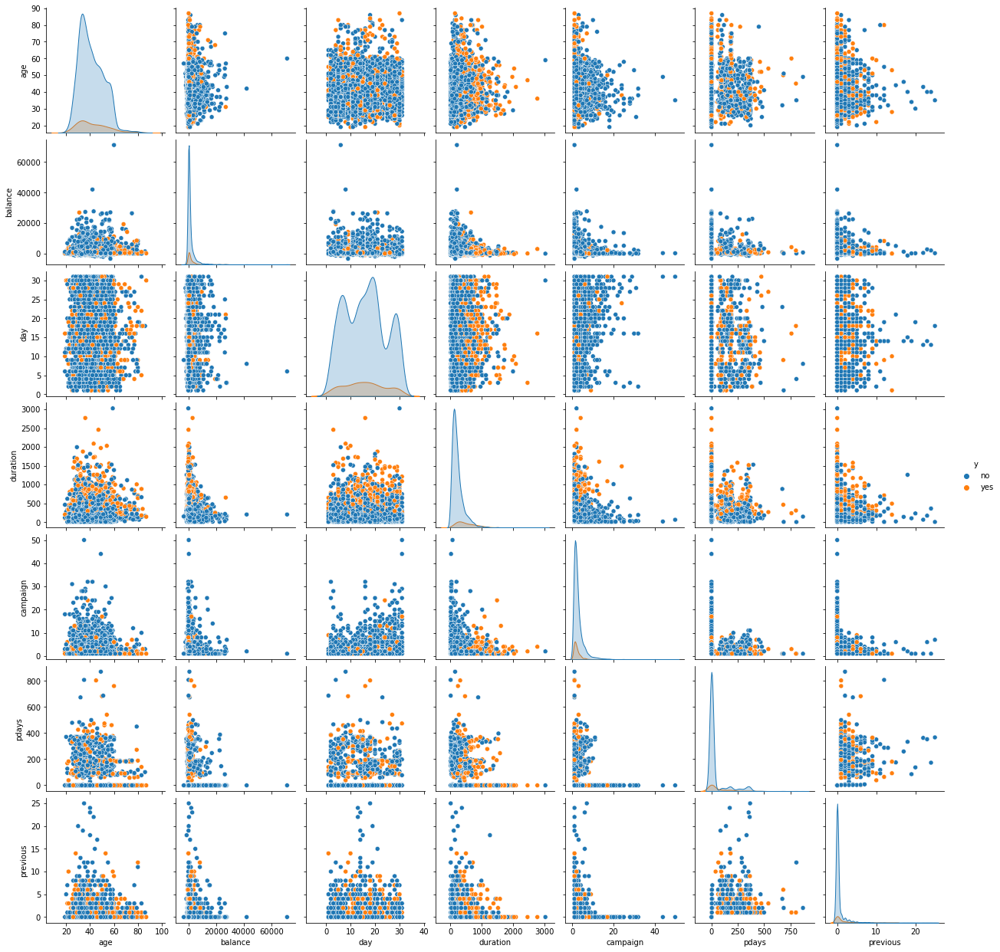

In [46]:
sns.pairplot(data=df,hue = 'y')

In [44]:
condition = np.array([True]*df.shape[0])
for col in df.columns:
    if df[col].dtype == 'int64':
        condition &= (np.abs(stats.zscore(df[col]))<float(3))

(4521,)
(4521,)
(4521,)
(4521,)
(4521,)
(4521,)
(4521,)
(4521,)
(4521,)
(4521,)
(4521,)
(4521,)
(4521,)
(4521,)
(4521,)
(4521,)
(4521,)


In [45]:
df_new = df[condition]

In [9]:
#strong outliners?
df.max()/df.mean()

age          2.11318
balance      50.0387
campaign     17.8979
contact          NaN
day          1.94781
default          NaN
duration       11.46
education        NaN
housing          NaN
job              NaN
loan             NaN
marital          NaN
month            NaN
pdays        21.9028
poutcome         NaN
previous     46.0762
y                NaN
dtype: object

In [8]:
for col in df.columns:
    print(col,":",df[col].unique())


age : [30 33 35 59 36 39 41 43 20 31 40 56 37 25 38 42 44 26 55 67 53 68 32 49
 78 23 52 34 61 45 48 57 54 63 51 29 50 27 60 28 21 58 22 46 24 77 75 47
 70 65 64 62 66 19 81 83 80 71 72 69 79 73 86 74 76 87 84]
job : ['unemployed' 'services' 'management' 'blue-collar' 'self-employed'
 'technician' 'entrepreneur' 'admin.' 'student' 'housemaid' 'retired'
 'unknown']
marital : ['married' 'single' 'divorced']
education : ['primary' 'secondary' 'tertiary' 'unknown']
default : ['no' 'yes']
balance : [ 1787  4789  1350 ...  -333 -3313  1137]
housing : ['no' 'yes']
loan : ['no' 'yes']
contact : ['cellular' 'unknown' 'telephone']
day : [19 11 16  3  5 23 14  6 17 20 13 30 29 27  7 18 12 21 26 22  2  4 15  8
 28  9  1 10 31 25 24]
month : ['oct' 'may' 'apr' 'jun' 'feb' 'aug' 'jan' 'jul' 'nov' 'sep' 'mar' 'dec']
duration : [  79  220  185  199  226  141  341  151   57  313  273  113  328  261
   89  189  239  114  250  148   96  140  109  125  169  182  247  119
  149   74  897   81   40  958  35

In [63]:
from sklearn.model_selection import train_test_split
y, X = df['y'], pd.get_dummies(df['job'], prefix='job', drop_first=True)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=101)

In [64]:
from sklearn.linear_model import LogisticRegression

logmodel = LogisticRegression()
logmodel.fit(X_train,y_train)
print(logmodel.coef_)

[[-0.62848364 -0.49856863 -0.05421408 -0.04562659  0.71208334 -0.09192814
  -0.3680459   0.57344658 -0.13256355 -0.12714416  0.56827462]]


In [71]:
logmodel.score(X_train,y_train)

0.8843236409608091

In [65]:
logmodel.score(X_test,y_test)

0.8857774502579219

In [ ]:
# y ~ job
#~0.8857774502579219

In [73]:
from sklearn.model_selection import train_test_split
y, X = df['y'], pd.get_dummies(df[['job','contact']], drop_first=True).join(df['duration'])
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=101)

In [77]:
from sklearn.linear_model import LogisticRegression
logmodel = LogisticRegression(max_iter=1000)
logmodel.fit(X_train,y_train)
print(logmodel.coef_)

[[-0.84077427 -0.75236545 -0.39797268 -0.14245893  0.51897631 -0.21107614
  -0.39796883  0.55823914 -0.25297109 -0.32915335  0.46135919 -0.03296691
  -1.40439041  0.00393958]]


In [79]:
logmodel.score(X_train, y_train)

0.8928571428571429

In [78]:
logmodel.score(X_test, y_test)

0.8953574060427414

In [ ]:
#classfication_report

In [ ]:
#logistic L1